In [6]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import xgboost as xgb
import matplotlib.pyplot as plt

In [243]:
df =  pd.read_csv('../US_Accidents_March23.csv', nrows=300000)
df.head(5)

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-1,Source2,3,2016-02-08 05:46:00,2016-02-08 11:00:00,39.865147,-84.058723,NaN,NaN,0.01,...,False,False,False,False,False,False,Night,Night,Night,Night
1,A-2,Source2,2,2016-02-08 06:07:59,2016-02-08 06:37:59,39.928059,-82.831184,NaN,NaN,0.01,...,False,False,False,False,False,False,Night,Night,Night,Day
2,A-3,Source2,2,2016-02-08 06:49:27,2016-02-08 07:19:27,39.063148,-84.032608,NaN,NaN,0.01,...,False,False,False,False,True,False,Night,Night,Day,Day
3,A-4,Source2,3,2016-02-08 07:23:34,2016-02-08 07:53:34,39.747753,-84.205582,NaN,NaN,0.01,...,False,False,False,False,False,False,Night,Day,Day,Day
4,A-5,Source2,2,2016-02-08 07:39:07,2016-02-08 08:09:07,39.627781,-84.188354,NaN,NaN,0.01,...,False,False,False,False,True,False,Day,Day,Day,Day


In [244]:
# Data Cleaning
df.isnull().sum()

ID                            0
Source                        0
Severity                      0
Start_Time                    0
End_Time                      0
Start_Lat                     0
Start_Lng                     0
End_Lat                  300000
End_Lng                  300000
Distance(mi)                  0
Description                   0
Street                        0
City                         16
County                        0
State                         0
Zipcode                      30
Country                       0
Timezone                     30
Airport_Code                 30
Weather_Timestamp          2470
Temperature(F)             4356
Wind_Chill(F)            264385
Humidity(%)                4807
Pressure(in)               3513
Visibility(mi)             6663
Wind_Direction             2484
Wind_Speed(mph)           57754
Precipitation(in)        270964
Weather_Condition          6131
Amenity                       0
Bump                          0
Crossing

In [245]:
print(df.shape)

# Find columns with null percentage greater than 80%
null_percentage_threshold = 80
high_null_columns = df.columns[df.isnull().mean() * 100 > null_percentage_threshold]

print("\nColumns with null percentage greater than 80%:")
print(high_null_columns)

# Remove columns with null percentage greater than 80%
df = df.drop(columns=high_null_columns)

print("\n",df.shape)

(300000, 46)

Columns with null percentage greater than 80%:
Index(['End_Lat', 'End_Lng', 'Wind_Chill(F)', 'Precipitation(in)'], dtype='object')

 (300000, 42)


In [246]:
# Drop ID column
df.drop(columns = ['ID', 
                   'Description', 
                   ], inplace = True)

In [247]:
# Assuming 'Start_Time' and 'End_Time' are in datetime format
df['Start_Time'] = pd.to_datetime(df['Start_Time'])
df['End_Time'] = pd.to_datetime(df['End_Time'])

# Create new columns
df['Start_Day'] = df['Start_Time'].dt.day
df['Start_Hour'] = df['Start_Time'].dt.hour
df['Start_Week'] = df['Start_Time'].dt.week
df['Start_Month'] = df['Start_Time'].dt.month
df['Start_Year'] = df['Start_Time'].dt.year

df['End_Day'] = df['End_Time'].dt.day
df['End_Hour'] = df['End_Time'].dt.hour
df['End_Week'] = df['End_Time'].dt.week
df['End_Month'] = df['End_Time'].dt.month
df['End_Year'] = df['End_Time'].dt.year

# Drop the original columns
df = df.drop(columns=['Start_Time', 'End_Time'])

Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.


In [248]:
# removing rows with null values
print(df.shape)
df.dropna(inplace = True)
print(df.shape)

(300000, 48)
(238739, 48)


In [249]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 238739 entries, 2 to 299999
Data columns (total 48 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   Source                 238739 non-null  object 
 1   Severity               238739 non-null  int64  
 2   Start_Lat              238739 non-null  float64
 3   Start_Lng              238739 non-null  float64
 4   Distance(mi)           238739 non-null  float64
 5   Street                 238739 non-null  object 
 6   City                   238739 non-null  object 
 7   County                 238739 non-null  object 
 8   State                  238739 non-null  object 
 9   Zipcode                238739 non-null  object 
 10  Country                238739 non-null  object 
 11  Timezone               238739 non-null  object 
 12  Airport_Code           238739 non-null  object 
 13  Weather_Timestamp      238739 non-null  object 
 14  Temperature(F)         238739 non-nu

In [250]:
# encoding categorical data
categorical_columns = df.select_dtypes(include=['object','bool']).columns
categorical_columns

Index(['Source', 'Street', 'City', 'County', 'State', 'Zipcode', 'Country',
       'Timezone', 'Airport_Code', 'Weather_Timestamp', 'Wind_Direction',
       'Weather_Condition', 'Amenity', 'Bump', 'Crossing', 'Give_Way',
       'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station', 'Stop',
       'Traffic_Calming', 'Traffic_Signal', 'Turning_Loop', 'Sunrise_Sunset',
       'Civil_Twilight', 'Nautical_Twilight', 'Astronomical_Twilight'],
      dtype='object')

In [251]:
from sklearn import preprocessing
label_encoders = {}

# Encoding categorical columns
for col in categorical_columns:
    le = preprocessing.LabelEncoder()
    df[col] = le.fit_transform(df[col])
    label_encoders[col] = le

df.head()

,Source,Severity,Start_Lat,Start_Lng,Distance(mi),Street,City,County,State,Zipcode,...,Start_Day,Start_Hour,Start_Week,Start_Month,Start_Year,End_Day,End_Hour,End_Week,End_Month,End_Year
2,0,2,39.063148,-84.032608,0.01,25461,3547,105,18,18863,...,8,6,6,2,2016,8,7,6,2,2016
3,0,3,39.747753,-84.205582,0.01,12598,794,318,18,19677,...,8,7,6,2,2016,8,7,6,2,2016
4,0,2,39.627781,-84.188354,0.01,16046,794,318,18,20036,...,8,7,6,2,2016,8,8,6,2,2016
5,0,3,40.100590,-82.925194,0.01,29437,3507,167,18,18196,...,8,7,6,2,2016,8,8,6,2,2016
6,0,2,39.758274,-84.230507,0.00,18145,794,318,18,19718,...,8,7,6,2,2016,8,8,6,2,2016


In [252]:
# Separate features (X) and target variable (y)

y = df['Severity'].copy()
X = df.drop('Severity', axis=1).copy()
column_names = X.columns

column_names

Index(['Source', 'Start_Lat', 'Start_Lng', 'Distance(mi)', 'Street', 'City',
       'County', 'State', 'Zipcode', 'Country', 'Timezone', 'Airport_Code',
       'Weather_Timestamp', 'Temperature(F)', 'Humidity(%)', 'Pressure(in)',
       'Visibility(mi)', 'Wind_Direction', 'Wind_Speed(mph)',
       'Weather_Condition', 'Amenity', 'Bump', 'Crossing', 'Give_Way',
       'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station', 'Stop',
       'Traffic_Calming', 'Traffic_Signal', 'Turning_Loop', 'Sunrise_Sunset',
       'Civil_Twilight', 'Nautical_Twilight', 'Astronomical_Twilight',
       'Start_Day', 'Start_Hour', 'Start_Week', 'Start_Month', 'Start_Year',
       'End_Day', 'End_Hour', 'End_Week', 'End_Month', 'End_Year'],
      dtype='object')

In [253]:
y = y-1
y.unique()

array([1, 2, 0, 3], dtype=int64)

In [254]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("X_train: ", X_train.shape)
print("y_train: ", y_train.shape)
print("X_test: ", X_test.shape)
print("y_test: ", y_test.shape)

X_train:  (190991, 47)
y_train:  (190991,)
X_test:  (47748, 47)
y_test:  (47748,)


In [14]:
# Convert the training and testing data into DMatrix format, which is optimized for XGBoost
# dtrain = xgb.DMatrix(X_train, label=y_train, enable_categorical=True)
# dtest = xgb.DMatrix(X_test, label=y_test, enable_categorical=True)

# dtrain

In [150]:
model = xgb.XGBClassifier()

In [151]:
# Train the model 
import time

start_time = time.time()
model.fit(X_train, y_train, verbose=True)
end_time = time.time()

elapsed_time = end_time - start_time
print("Time taken for model fitting:", elapsed_time, "seconds")

Time taken for model fitting: 39.40330410003662 seconds


In [152]:
# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.9159471061331228


In [153]:
# Save the trained model to a file in JSON format
model.save_model("xgboost_model.json")

# Load the saved model from the file
# model = xgb.Booster()
# model.load_model("xgboost_model.json")

# __SHAP__

In [24]:
import shap
shap.initjs()

In [25]:
# Create a SHAP explainer object for the trained XGBoost model
explainer = shap.TreeExplainer(model)

In [26]:
X_test_sample = X_test[:1000]

start_time = time.time()
shap_values = explainer(X_test_sample)
end_time = time.time()

elapsed_time = end_time - start_time
print("Time taken for calculating SHAP values:", elapsed_time, "seconds")

Time taken for calculating SHAP values: 6.517077445983887 seconds


In [27]:
shap_values

.values =
array([[[ 0.0000000e+00, -4.0985105e-04, -1.2551951e-05, -3.1221923e-03],
        [-4.8876023e-01, -7.6433972e-02, -1.7051667e-01,  4.5971343e-01],
        [ 3.5980560e-02,  1.5888688e-01, -2.4235894e-01, -2.8342053e-02],
        ...,
        [ 9.3842763e-03,  7.2745453e-03, -5.2756444e-03, -1.1005575e-02],
        [ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  6.1644049e-04],
        [ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00]],

       [[ 0.0000000e+00,  2.6271088e-04, -9.0891335e-05, -6.8874275e-03],
        [-1.7446490e-01,  2.4253668e-01, -1.7405894e-01, -3.1611946e-01],
        [-1.3831362e-01,  2.6285952e-01, -5.1073647e-01, -7.3726964e-01],
        ...,
        [ 1.1102463e-02,  2.9961001e-03, -2.6514854e-03, -1.3578378e-03],
        [ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00, -8.4669556e-04],
        [ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00]],

       [[ 0.0000000e+00,  8.0848193e-05, -1.3769319e-05, -5.0717434e-03]

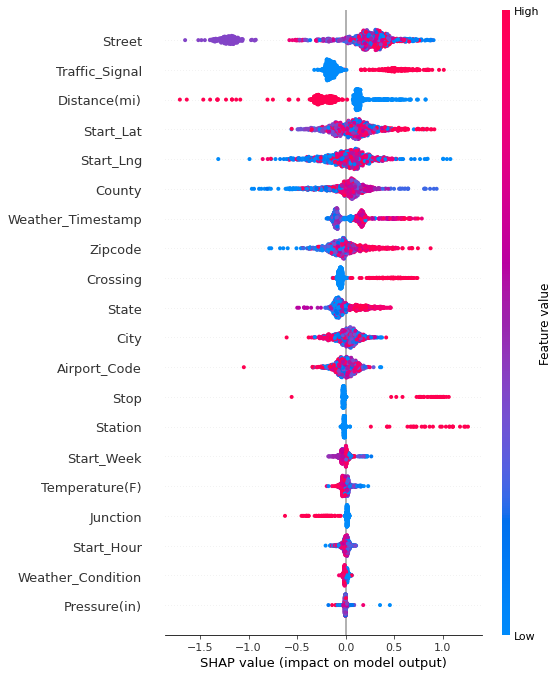

In [28]:
# Summary plot
shap.summary_plot(shap_values[:,:,1], feature_names=column_names, show=False)

plt.savefig('shap_summary_plot_class_1.png', dpi=300)
plt.show()

In [46]:
mp = model.predict
print(mp)

<bound method XGBClassifier.predict of XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)>


In [33]:
# Force plot 
shap.plots.force(shap_values[:,:,1], feature_names=column_names, show=False)

# plt.savefig('shap_force_plot_class_1_all.png',bbox_inches='tight', dpi=300)
# plt.show()

In [51]:
# Force plot 
shap.plots.force(shap_values[190,:,1], feature_names=column_names, show=False)

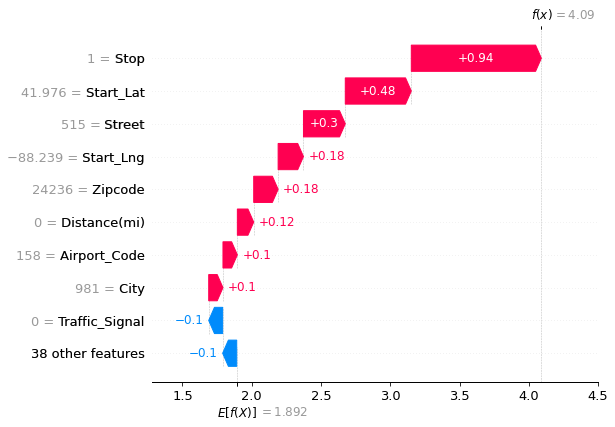

<Figure size 432x288 with 0 Axes>

In [54]:
# Waterfall Plot
shap.plots.waterfall(shap_values[500,:,1])

plt.savefig('shap_waterfall_plot_class_1.png',bbox_inches='tight', dpi=300)
plt.show()

In [55]:
feature_columns = X_test_sample.columns

# Print feature index for each feature
for feature_index, feature_name in enumerate(feature_columns):
    print(f"{feature_name} : {feature_index}")

Source : 0
Start_Lat : 1
Start_Lng : 2
Distance(mi) : 3
Street : 4
City : 5
County : 6
State : 7
Zipcode : 8
Country : 9
Timezone : 10
Airport_Code : 11
Weather_Timestamp : 12
Temperature(F) : 13
Humidity(%) : 14
Pressure(in) : 15
Visibility(mi) : 16
Wind_Direction : 17
Wind_Speed(mph) : 18
Weather_Condition : 19
Amenity : 20
Bump : 21
Crossing : 22
Give_Way : 23
Junction : 24
No_Exit : 25
Railway : 26
Roundabout : 27
Station : 28
Stop : 29
Traffic_Calming : 30
Traffic_Signal : 31
Turning_Loop : 32
Sunrise_Sunset : 33
Civil_Twilight : 34
Nautical_Twilight : 35
Astronomical_Twilight : 36
Start_Day : 37
Start_Hour : 38
Start_Week : 39
Start_Month : 40
Start_Year : 41
End_Day : 42
End_Hour : 43
End_Week : 44
End_Month : 45
End_Year : 46


In [67]:
def plot_dependence(feature_index, itr_index, pred_class):
    shap.dependence_plot(
        feature_index,
        shap_values.values[:, :, pred_class],  # Assuming you want to plot the SHAP values for the first class
        X_test_sample,
        feature_names=X_test_sample.columns,
        interaction_index=itr_index,  # Set to "auto" to automatically choose the interaction feature
        show=False  # Set to True if you want to display the plot using matplotlib
    )

    name = 'dependency_plot_' + str(feature_index) + '_' + str(itr_index) + '.png'
    plt.savefig(name, bbox_inches='tight', dpi=300)
    plt.show()

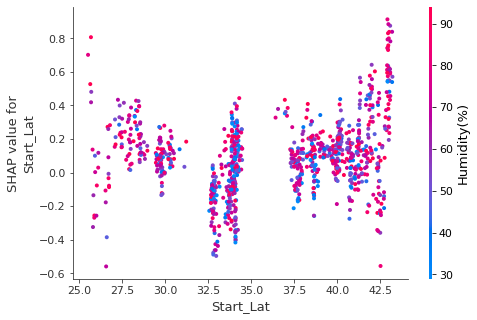

In [68]:
# Create a SHAP dependence plot
plot_dependence(1,14,1)

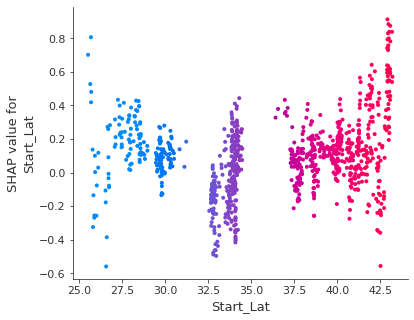

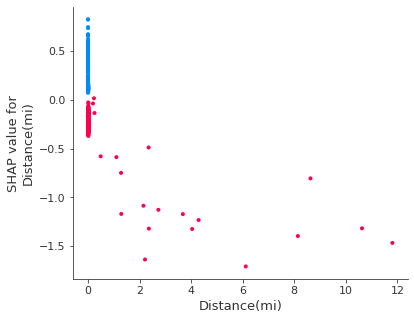

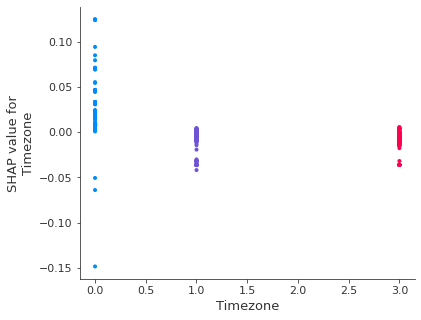

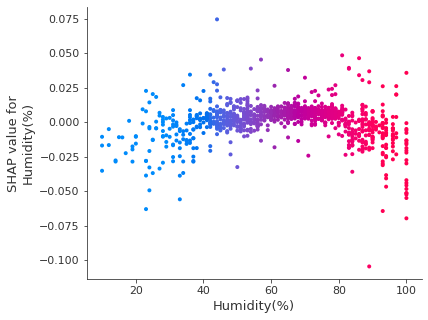

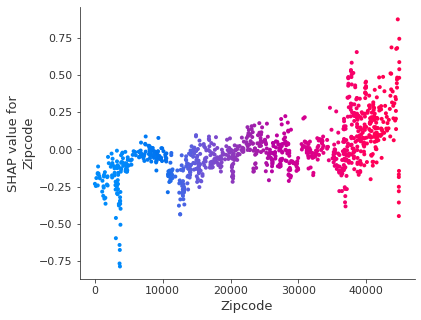

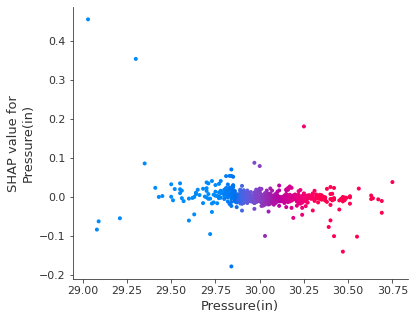

In [70]:
# Create a SHAP dependence plot
consider_idx = [1,3,10,14,8,15]

for i in consider_idx:
    plot_dependence(i,i,1)

In [71]:
#interaction values

start_time = time.time()
shap_interaction_values = explainer.shap_interaction_values(X_test_sample)
end_time = time.time()

elapsed_time = end_time - start_time
print("Time taken for calculating Interaction values:", elapsed_time, "seconds")

Time taken for calculating Interaction values: 404.9025664329529 seconds


In [72]:
shap_interaction_values

[array([[[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00, -4.04984266e-01, -3.41797359e-02, ...,
           1.20815821e-05,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00, -3.41797620e-02,  1.96539149e-01, ...,
           4.47984319e-04,  0.00000000e+00,  0.00000000e+00],
         ...,
         [ 0.00000000e+00,  1.20997429e-05,  4.47984785e-04, ...,
           1.01192053e-02,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],
 
        [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00, -1.19718269e-01, -1.47393852e-01, ...,
           1.20811164

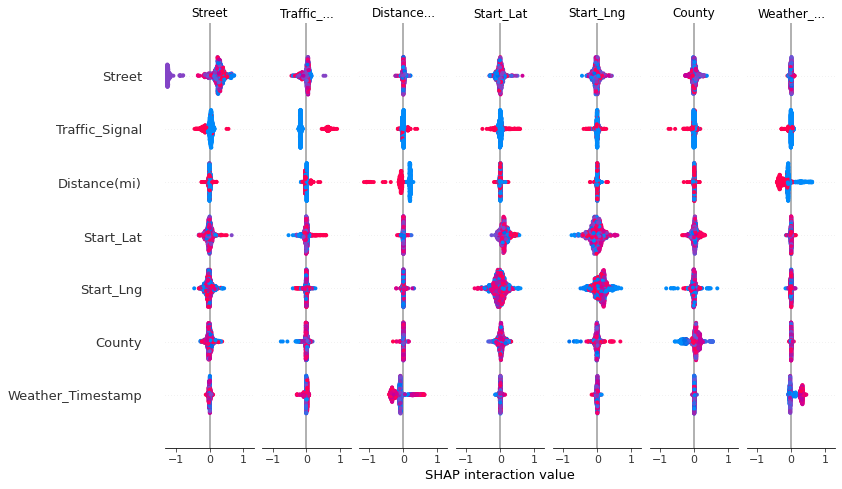

<Figure size 432x288 with 0 Axes>

In [74]:
shap.summary_plot(shap_interaction_values[1], X_test_sample)

plt.savefig('shap_interaction_summary_plot_class_1.png',bbox_inches='tight', dpi=300)
plt.show()

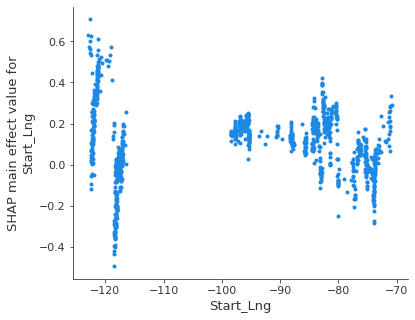

In [75]:
shap.dependence_plot(
    ("Start_Lng", "Start_Lng"),
    shap_interaction_values[1], X_test_sample,
    display_features=X_test_sample
)

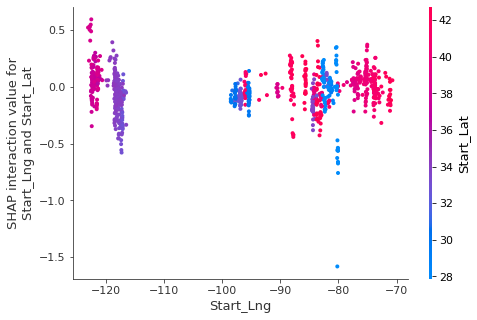

<Figure size 432x288 with 0 Axes>

In [76]:
shap.dependence_plot(
    ("Start_Lng", "Start_Lat"),
    shap_interaction_values[1], X_test_sample,
    display_features=X_test_sample
)

plt.savefig('shap_interaction_dependence_plot_class_1.png',bbox_inches='tight', dpi=300)
plt.show()

# LIME

In [77]:
from lime import lime_tabular

In [255]:
explainer_lime = lime_tabular.LimeTabularExplainer(X_train.values, feature_names=column_names, class_names=['0', '1', '2', '3'], verbose=True, mode='classification')

In [256]:
predict_fn = lambda a: model.predict_proba(a)

In [257]:
def limeExplain(i):
    exp = explainer_lime.explain_instance(X_test.values[i], predict_fn, top_labels=1, num_features=9)
    # Show the explanation
    exp.show_in_notebook(show_table=True, show_all=False)
    
#     plt.savefig(str(i) + '_lime.png', dpi=300)
#     plt.show()

In [258]:
y_pred = model.predict(X_test)
unique_values, indices = np.unique(y_pred, return_inverse=True)
print(unique_values)

# Create a dictionary to store unique values and their indices
unique_dict = {}
for value in unique_values:
    unique_dict[value] = np.where(y_pred == value)[0].tolist()

print('-----------------------------------------------\n',unique_dict[0])
print('-----------------------------------------------\n',unique_dict[1])
print('-----------------------------------------------\n',unique_dict[2])
print('-----------------------------------------------\n',unique_dict[3])

[0 1 2 3]
-----------------------------------------------
 [26464]
-----------------------------------------------
 [0, 1, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 92, 93, 94, 97, 99, 100, 101, 102, 103, 104, 105, 106, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 147, 148, 149, 150, 154, 155, 156, 158, 159, 160, 161, 162, 166, 167, 168, 169, 170, 171, 173, 174, 175, 176, 177, 179, 180, 181, 182, 183, 184, 186, 187, 188, 189, 190, 191, 192, 195, 196, 197, 198, 199, 201, 202, 203, 204, 206, 207, 208, 209, 210, 212, 213, 215, 216, 218, 219, 220, 221, 222, 223, 224, 225, 22

In [259]:
indices = [26464,378,1371,5211, 33210, 1202, 36942, 35722, 47369, 12805, 13265, 18558]

for i in indices:
    limeExplain(i)

Intercept -0.003137799208135542
Prediction_local [0.00669561]
Right: 0.3802788


Intercept 1.1165537516713075
Prediction_local [0.99841514]
Right: 0.9968118


Intercept 1.2135429443488865
Prediction_local [0.77301277]
Right: 0.96070755


Intercept 0.8215592409903318
Prediction_local [1.18727304]
Right: 0.99888736


Intercept 0.931285815135608
Prediction_local [1.03147964]
Right: 0.99158704


Intercept -0.2438829896300398
Prediction_local [0.26016969]
Right: 0.7992803


Intercept -0.4883638070383671
Prediction_local [0.26988259]
Right: 0.55488867


Intercept -0.5456911524914357
Prediction_local [0.3768265]
Right: 0.69103944


Intercept -0.3509550546008189
Prediction_local [0.15092047]
Right: 0.55846304


Intercept -0.0016183539433631783
Prediction_local [0.00467869]
Right: 0.48491675


Intercept -0.0009436158340673845
Prediction_local [0.00482648]
Right: 0.4692569


Intercept -0.0010152080760326308
Prediction_local [0.00470553]
Right: 0.45109302
